# Fine-Tuning Qwen2-VL-2B for Object Detection

## Overview
This notebook demonstrates how to fine-tune the **Qwen2-VL-2B-Instruct** model for detecting nutrition tables in product images. This is a lighter-weight alternative to the 7B model, making it more accessible for users with limited GPU resources.

### Why Use the 2B Model?
- **Lower memory requirements**: Can run on a single consumer GPU (e.g., RTX 3090, RTX 4090)
- **Faster training**: Reduced parameter count means quicker iterations
- **Still capable**: Despite being smaller, the 2B model retains strong vision-language capabilities

### Dataset
We use the [openfoodfacts/nutrition-table-detection](https://huggingface.co/datasets/openfoodfacts/nutrition-table-detection) dataset, which contains product images with bounding box annotations for nutrition tables.

## 1. Install Dependencies

First, let's install all required packages. We need the latest versions of transformers and TRL for Vision Language Model support.

In [1]:
# Install core dependencies for VLM fine-tuning
!pip install -U -q git+https://github.com/huggingface/transformers.git git+https://github.com/huggingface/trl.git datasets bitsandbytes peft qwen-vl-utils wandb accelerate

# Visualization libraries
!pip install -q matplotlib IPython

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.6/511.6 kB 17.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 42.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 516.2/516.2 kB 43.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.7/47.7 MB 45.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 MB 63.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentence-transformers 5.1.2 requires transformers<5.0.0,>=4.41.0, but you have transformers 5.0.0.dev0 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
# Install compatible PyTorch version (addresses known compatibility issues)
!pip install -q torch==2.4.1+cu121 torchvision==0.19.1+cu121 torchaudio==2.4.1+cu121 --extra-index-url https://download.pytorch.org/whl/cu121

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 798.9/798.9 MB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 129.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 57.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 95.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 50.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 127.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 45.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━

### Optional: Flash Attention Installation
Flash Attention 2 can significantly speed up training and reduce memory usage, but requires Ampere GPUs (A100, A6000, RTX 30xx/40xx series). Uncomment the cell below if you want to enable it.

In [3]:
# Uncomment to install Flash Attention (requires compatible GPU)
# !pip install flash-attn --no-build-isolation

## 2. Hugging Face Authentication

Log in to Hugging Face to access gated models and upload your fine-tuned model.

In [4]:
from google.colab import userdata
from huggingface_hub import login

# Login using your HF token (set in Colab secrets)
login(token=userdata.get('HF_TOKEN'))

## 3. Model Configuration

Here we define our model and training hyperparameters. The key difference from the 7B notebook is the use of `Qwen/Qwen2-VL-2B-Instruct` - the smaller, more efficient variant.

In [5]:
# Model selection - using the 2B variant for efficiency
model_id = "Qwen/Qwen2-VL-2B-Instruct"

# Training hyperparameters - adjusted for the smaller model
# The 2B model can handle larger batch sizes due to lower memory footprint
PD_BATCH = 8   # Per-device batch size (increased from 4 in 7B version)
GA_STEPS = 8   # Gradient accumulation steps (reduced since we have larger batches)

### Notebook Display Settings

In [6]:
from IPython.display import display, HTML
from IPython.core.interactiveshell import InteractiveShell

display(HTML("<style>.container { width:100% !important; }</style>"))
InteractiveShell.ast_node_interactivity = "all"
%matplotlib inline

## 4. Load and Explore the Dataset

The nutrition-table-detection dataset contains:
- **Images**: Product photos with nutrition labels
- **Bounding boxes**: Normalized coordinates (0-1) in format `[x_min, y_min, x_max, y_max]`
- **Metadata**: Barcode info and image URLs

Bounding boxes are normalized to be resolution-independent, which helps with consistent training across different image sizes.

In [7]:
from datasets import load_dataset

# Load the nutrition table detection dataset
dataset_id = "openfoodfacts/nutrition-table-detection"
dataset = load_dataset(dataset_id)

# Display dataset info
print(f"Dataset loaded successfully!")
print(f"Training samples: {len(dataset['train'])}")
print(f"Validation samples: {len(dataset['val'])}")
print(f"\nSample structure:")
print(dataset['train'][0])

README.md: 0.00B [00:00, ?B/s]

data/train-00000-of-00002.parquet:   0%|          | 0.00/291M [00:00<?, ?B/s]

data/train-00001-of-00002.parquet:   0%|          | 0.00/285M [00:00<?, ?B/s]

data/val-00000-of-00001.parquet:   0%|          | 0.00/64.2M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/1083 [00:00<?, ? examples/s]

Generating val split:   0%|          | 0/123 [00:00<?, ? examples/s]

Dataset loaded successfully!
Training samples: 1083
Validation samples: 123

Sample structure:
{'image_id': '0009800892204_1', 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2592x1944 at 0x7C77061DD460>, 'width': 2592, 'height': 1944, 'meta': {'barcode': '0009800892204', 'off_image_id': '1', 'image_url': 'https://static.openfoodfacts.org/images/products/000/980/089/2204/1.jpg'}, 'objects': {'bbox': [[0.057098764926195145, 0.014274691231548786, 0.603501558303833, 0.991126537322998]], 'category_id': [0], 'category_name': ['nutrition-table']}}


### Visualize a Sample

Let's visualize a sample image with its bounding box to understand the data format.

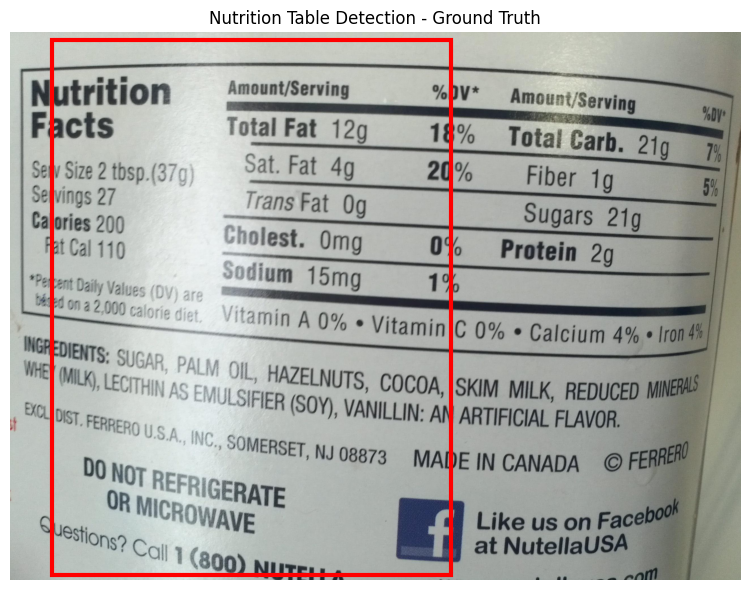

In [8]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def show_sample_with_bbox(sample, idx=0):
    """Display an image with its bounding box annotation.

    The bbox format is [x_min, y_min, x_max, y_max] normalized to [0, 1].
    We convert back to pixel coordinates for visualization.
    """
    img = sample["image"].convert("RGB")
    bboxes = sample["objects"]["bbox"]

    if not bboxes:
        print("No bounding boxes in this sample")
        return

    width, height = img.size
    bbox = bboxes[idx]

    # Convert normalized coords to pixels
    x_min, y_min, x_max, y_max = bbox
    x0 = x_min * width
    y0 = y_min * height
    w = (x_max - x_min) * width
    h = (y_max - y_min) * height

    # Plot
    fig, ax = plt.subplots(figsize=(8, 8 * height / width))
    ax.imshow(img)
    rect = patches.Rectangle((x0, y0), w, h, linewidth=3, edgecolor='red', facecolor='none')
    ax.add_patch(rect)
    ax.set_title("Nutrition Table Detection - Ground Truth")
    ax.axis('off')
    plt.tight_layout()
    plt.show()

# Visualize the first training example
show_sample_with_bbox(dataset['train'][0])

## 5. Data Preparation for Training

We need to convert the dataset to the ChatML format expected by Qwen2-VL. Each sample becomes a conversation with:
- **System message**: Instructions for the model
- **User message**: Image + detection prompt
- **Assistant message**: Bounding box in Qwen's format

Qwen2-VL uses a special format for bounding boxes: `<|object_ref_start|>class_name<|object_ref_end|><|box_start|>(x1,y1),(x2,y2)<|box_end|>` where coordinates are scaled to 0-1000.

In [9]:
# System prompt for the object detection task
SYSTEM_PROMPT = """You are a Vision Language Model specialized in interpreting visual data from product images.
Your task is to analyze the provided product images and detect the nutrition tables in a certain format.
Focus on delivering accurate, succinct answers based on the visual information. Avoid additional explanation unless absolutely necessary."""

In [10]:
from tqdm import tqdm

def convert_bbox_to_qwen_format(bbox):
    """Convert normalized bbox [x_min, y_min, x_max, y_max] to Qwen's 0-1000 scale.

    Qwen expects: <|object_ref_start|>class<|object_ref_end|><|box_start|>(x1,y1),(x2,y2)<|box_end|>
    """
    x_min, y_min, x_max, y_max = bbox
    # Scale to 0-1000 range
    x1 = int(x_min * 1000)
    y1 = int(y_min * 1000)
    x2 = int(x_max * 1000)
    y2 = int(y_max * 1000)

    return f"<|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>({x1},{y1}),({x2},{y2})<|box_end|>"

def convert_sample_to_chatml(sample):
    """Convert a dataset sample to ChatML format for training."""
    img = sample["image"]
    bboxes = sample["objects"]["bbox"]

    # Build the assistant response with all bounding boxes
    bbox_strings = [convert_bbox_to_qwen_format(bbox) for bbox in bboxes]
    assistant_response = "\n".join(bbox_strings)

    messages = [
        {
            "role": "system",
            "content": [{"type": "text", "text": SYSTEM_PROMPT}]
        },
        {
            "role": "user",
            "content": [
                {"type": "image", "image": img},
                {"type": "text", "text": "Detect the bounding box of the nutrition table."}
            ]
        },
        {
            "role": "assistant",
            "content": [{"type": "text", "text": assistant_response}]
        }
    ]

    return {"messages": messages, "image": img}

# Convert train and validation splits
print("Converting training set to ChatML format...")
train_chatml = [convert_sample_to_chatml(sample) for sample in tqdm(dataset['train'], desc="Converting train")]

print("Converting validation set to ChatML format...")
val_chatml = [convert_sample_to_chatml(sample) for sample in tqdm(dataset['val'], desc="Converting val")]

chat_splits = {"train": train_chatml, "val": val_chatml}
print(f"\nConversion complete! Train: {len(train_chatml)}, Val: {len(val_chatml)}")

Converting training set to ChatML format...


Converting train: 100%|██████████| 1083/1083 [00:35<00:00, 30.22it/s]


Converting validation set to ChatML format...


Converting val: 100%|██████████| 123/123 [00:03<00:00, 30.85it/s]


Conversion complete! Train: 1083, Val: 123


## 6. Memory Cleanup

Before loading the model for training, let's ensure GPU memory is clean.

In [11]:
import gc
import time
import torch

def clear_memory():
    """Free up GPU memory by clearing unused variables and cache."""
    for var_name in ['inputs', 'model', 'processor', 'trainer', 'peft_model', 'bnb_config']:
        if var_name in globals():
            del globals()[var_name]

    gc.collect()
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        torch.cuda.synchronize()
    time.sleep(1)
    print("Memory cleared!")

clear_memory()

Memory cleared!


## 7. Load the Model with Quantization

We load the Qwen2-VL-2B model with 4-bit quantization (NF4) for memory efficiency. This allows fine-tuning on consumer GPUs while maintaining good performance.

In [12]:
import torch
from transformers import AutoModelForVision2Seq, AutoProcessor, BitsAndBytesConfig

# Configure 4-bit quantization for memory efficiency
bnb_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_quant_type="nf4",
    bnb_4bit_compute_dtype=torch.bfloat16,
    bnb_4bit_use_double_quant=True,
)

# Load the 2B model - significantly smaller than 7B!
print(f"Loading model: {model_id}")
model = AutoModelForVision2Seq.from_pretrained(
    model_id,
    attn_implementation="sdpa",  # Use SDPA; change to "flash_attention_2" if available
    device_map="auto",
    torch_dtype=torch.bfloat16,
    quantization_config=bnb_config,
)

processor = AutoProcessor.from_pretrained(model_id)

print(f"Model dtype: {next(model.parameters()).dtype}")
print(f"Model loaded successfully!")

Loading model: Qwen/Qwen2-VL-2B-Instruct


/usr/local/lib/python3.12/dist-packages/transformers/models/auto/modeling_auto.py:2270: FutureWarning: The class `AutoModelForVision2Seq` is deprecated and will be removed in v5.0. Please use `AutoModelForImageTextToText` instead.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

`torch_dtype` is deprecated! Use `dtype` instead!
Unrecognized keys in `rope_parameters` for 'rope_type'='default': {'mrope_section'}


model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

Loading weights:   0%|          | 0/729 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/347 [00:00<?, ?B/s]

The image processor of type `Qwen2VLImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. Note that this behavior will be extended to all models in a future release.


tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]

Model dtype: torch.bfloat16
Model loaded successfully!


## 8. Configure QLoRA for Efficient Fine-Tuning

QLoRA (Quantized Low-Rank Adaptation) allows us to fine-tune the model efficiently by:
1. Keeping base weights frozen and quantized
2. Training only small low-rank adapter matrices

For the 2B model, we use a smaller rank (r=32) compared to 7B since the model is already more compact.

In [13]:
from peft import LoraConfig, get_peft_model, prepare_model_for_kbit_training

# Prepare model for k-bit training
model = prepare_model_for_kbit_training(model)

# LoRA configuration - adjusted for 2B model
lora_config = LoraConfig(
    r=32,                    # Rank (reduced from 64 for smaller model)
    lora_alpha=16,           # Scaling factor
    lora_dropout=0.05,       # Dropout for regularization
    bias="none",
    task_type="CAUSAL_LM",
    target_modules=[
        # Transformer decoder layers
        "q_proj", "k_proj", "v_proj", "o_proj",
        "gate_proj", "up_proj", "down_proj",
        # Vision encoder layers
        "fc1", "fc2",
    ],
)

# Apply LoRA to the model
model = get_peft_model(model, lora_config)
model.print_trainable_parameters()

trainable params: 50,036,736 || all params: 2,259,022,336 || trainable%: 2.2150


## 9. Configure the Training

We use TRL's SFTConfig for supervised fine-tuning. The 2B model allows for larger batch sizes and faster training.

In [46]:
from trl import SFTConfig

# Calculate warmup steps based on current configuration
# num_training_steps = (len(train_dataset) / per_device_train_batch_size / gradient_accumulation_steps) * num_train_epochs
# num_training_steps = (1083 / 8 / 8) * 3 = 50.765625
# warmup_steps = num_training_steps * warmup_ratio = 50.765625 * 0.05 = 2.538, rounded to 3
calculated_warmup_steps = 3

sft_config = SFTConfig(
    dataset_text_field="messages",

    # Training hyperparameters
    learning_rate=2e-4,
    per_device_train_batch_size=PD_BATCH,
    gradient_accumulation_steps=GA_STEPS,
    num_train_epochs=3,
    lr_scheduler_type="cosine",
    warmup_steps=calculated_warmup_steps, # Changed from warmup_ratio to warmup_steps

    # Memory optimization
    gradient_checkpointing=True,
    bf16=True,

    # Logging & checkpoints
    output_dir="./qwen2vl_2b_qlora_sft",
    logging_steps=10,
    save_strategy="epoch",
    eval_strategy="epoch",
    report_to=["tensorboard"], # Explicitly set to log to TensorBoard

    # Disable default tokenization (we handle it in collator)
    remove_unused_columns=False,
    dataset_kwargs={"skip_prepare_dataset": True},
)

## 10. Data Collator for Vision-Language Training

The collator handles batching of multimodal data, including proper processing of images and text.

In [47]:
from dataclasses import dataclass
from typing import Dict, List, Any
from qwen_vl_utils import process_vision_info

@dataclass
class QwenVLDataCollator:
    """Data collator for Qwen2-VL that handles multimodal inputs."""
    processor: Any

    def __call__(self, examples: List[Dict]) -> Dict[str, Any]:
        # Extract messages and images
        messages_batch = [ex["messages"] for ex in examples]

        # Apply chat template to get text
        texts = [
            self.processor.apply_chat_template(msgs, tokenize=False, add_generation_prompt=False)
            for msgs in messages_batch
        ]

        # Process vision info for each example
        image_inputs_list = []
        for msgs in messages_batch:
            image_inputs, _ = process_vision_info(msgs)
            image_inputs_list.append(image_inputs[0] if image_inputs else None)

        # Process with the Qwen processor
        batch = self.processor(
            text=texts,
            images=image_inputs_list,
            return_tensors="pt",
            padding=True,
            truncation=True,
        )

        # Set labels for causal LM training
        batch["labels"] = batch["input_ids"].clone()

        return batch

collator = QwenVLDataCollator(processor)

## 11. Create Trainer and Start Training

We use a custom SFTTrainer that handles some compatibility issues with Qwen2-VL.

In [48]:
from trl import SFTTrainer

class QwenVLSFTTrainer(SFTTrainer):
    """Custom SFTTrainer for Qwen2-VL compatibility."""

    def compute_loss(self, model, inputs, return_outputs=False, **kwargs):
        # Remove any extra keys that Qwen2VL doesn't expect
        inputs = dict(inputs)
        inputs.pop("num_items_in_batch", None)
        return super().compute_loss(model, inputs, return_outputs=return_outputs)

In [49]:
# Limit image size to reduce memory
processor.image_processor.max_pixels = 512 * 512

# Create the trainer
trainer = QwenVLSFTTrainer(
    model=model,
    train_dataset=chat_splits["train"],
    eval_dataset=chat_splits["val"],
    data_collator=collator,
    args=sft_config,
    processing_class=None,  # Disable built-in processing
    peft_config=lora_config,
)

# Start training!
print("Starting training...")
trainer.train()

/usr/local/lib/python3.12/dist-packages/peft/tuners/lora/bnb.py:397: UserWarning: Merge lora module to 4-bit linear may get different generations due to rounding errors.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:282: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


Starting training...


/usr/local/lib/python3.12/dist-packages/torch/_dynamo/eval_frame.py:600: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  return fn(*args, **kwargs)
/usr/local/lib/python3.12/dist-packages/torch/utils/checkpoint.py:295: FutureWarning: `torch.cpu.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cpu', args...)` instead.
  with torch.enable_grad(), device_autocast_ctx, torch.cpu.amp.autocast(**ctx.cpu_autocast_kwargs):  # type: ignore[attr-defined]


Epoch,Training Loss,Validation Loss,Entropy,Num Tokens,Mean Token Accuracy
1,105.308923,6.561718,7.062378,448934.000000,0.187570
2,48.558960,5.932146,6.269359,897868.000000,0.236336
3,47.054514,5.902578,6.229545,1346802.000000,0.236429


/usr/local/lib/python3.12/dist-packages/torch/_dynamo/eval_frame.py:600: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  return fn(*args, **kwargs)
/usr/local/lib/python3.12/dist-packages/torch/utils/checkpoint.py:295: FutureWarning: `torch.cpu.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cpu', args...)` instead.
  with torch.enable_grad(), device_autocast_ctx, torch.cpu.amp.autocast(**ctx.cpu_autocast_kwargs):  # type: ignore[attr-defined]
/usr/local/lib/python3.12/dist-packages/torch/_dynamo/eval_frame.py:600: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an except

TrainOutput(global_step=51, training_loss=60.68150075276693, metrics={'train_runtime': 1253.5311, 'train_samples_per_second': 2.592, 'train_steps_per_second': 0.041, 'total_flos': 1.687769636588544e+16, 'train_loss': 60.68150075276693, 'epoch': 3.0})

## 12. Save the Fine-Tuned Model

After training, save the LoRA adapter weights for later use.

In [50]:
# Save the final model
trainer.save_model("./qwen2vl_2b_nutrition_detector")
print("Model saved successfully!")

Model saved successfully!


## 13. Test the Fine-Tuned Model

Let's test our fine-tuned model on some validation examples.

In [51]:
import re
import torch
from torch.cuda.amp import autocast # Import autocast

def parse_qwen_bbox(answer):
    """Parse bounding box coordinates from Qwen's output format."""
    # Extract numbers from the format (x1,y1),(x2,y2)
    nums = list(map(int, re.findall(r"\d+", answer)))
    if len(nums) >= 4:
        return nums[:4]  # x1, y1, x2, y2
    return None

def run_inference(model, processor, image, prompt="Detect the bounding box of the nutrition table."):
    """Run inference on a single image."""
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "image", "image": image},
                {"type": "text", "text": prompt}
            ]
        }
    ]

    text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
    image_inputs, _ = process_vision_info(messages)

    inputs = processor(
        text=[text],
        images=image_inputs,
        return_tensors="pt",
        padding=True,
    ).to(model.device) # Remove explicit dtype here, autocast will handle it

    with torch.no_grad():
        with torch.amp.autocast('cuda', dtype=torch.bfloat16): # Wrap generation in autocast, updated to avoid warning
            outputs = model.generate(**inputs, max_new_tokens=64)

    response = processor.decode(outputs[0], skip_special_tokens=False)
    # Extract just the assistant's response
    if "<|im_start|>assistant" in response:
        response = response.split("<|im_start|>assistant")[-1]
    return response.strip()

# Test on a validation sample
sample = chat_splits["val"][5]
img = sample["image"].convert("RGB")
answer = run_inference(model, processor, img)
print(f"Model prediction: {answer}")

Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(217,187),(719,719)<|box_end|><|im_end|>


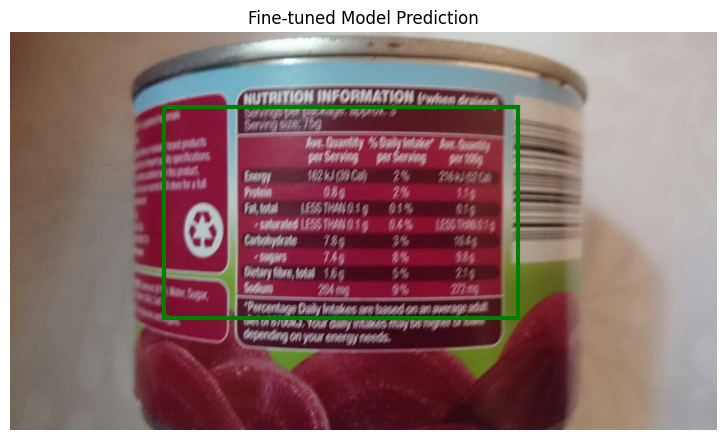

In [52]:
def visualize_prediction(img, answer, processor):
    """Visualize the predicted bounding box on the image."""
    bbox = parse_qwen_bbox(answer)
    if bbox is None:
        print("Could not parse bounding box from model output")
        return

    x1, y1, x2, y2 = bbox
    width, height = img.size

    # Convert from 0-1000 scale to pixel coordinates
    x0 = x1 / 1000 * width
    y0 = y1 / 1000 * height
    w = (x2 - x1) / 1000 * width
    h = (y2 - y1) / 1000 * height

    # Plot
    fig, ax = plt.subplots(figsize=(8, 8 * height / width))
    ax.imshow(img)
    rect = patches.Rectangle((x0, y0), w, h, linewidth=3, edgecolor='green', facecolor='none')
    ax.add_patch(rect)
    ax.set_title("Fine-tuned Model Prediction")
    ax.axis('off')
    plt.tight_layout()
    plt.show()

# Visualize the prediction
visualize_prediction(img, answer, processor)

## Summary

In this notebook, we successfully:

1. **Loaded the Qwen2-VL-2B model** - A lightweight alternative to the 7B version
2. **Prepared the nutrition-table-detection dataset** - Converted to ChatML format
3. **Applied QLoRA** - Efficient fine-tuning with quantization
4. **Trained the model** - Using TRL's SFTTrainer
5. **Tested the results** - Visualized predictions on validation data

In [42]:
!ls -R ./qwen2vl_2b_qlora_sft

./qwen2vl_2b_qlora_sft:
checkpoint-17  checkpoint-34  checkpoint-51  README.md

./qwen2vl_2b_qlora_sft/checkpoint-17:
adapter_config.json	   processor_config.json  tokenizer_config.json
adapter_model.safetensors  README.md		  tokenizer.json
chat_template.jinja	   rng_state.pth	  trainer_state.json
optimizer.pt		   scheduler.pt		  training_args.bin

./qwen2vl_2b_qlora_sft/checkpoint-34:
adapter_config.json	   processor_config.json  tokenizer_config.json
adapter_model.safetensors  README.md		  tokenizer.json
chat_template.jinja	   rng_state.pth	  trainer_state.json
optimizer.pt		   scheduler.pt		  training_args.bin

./qwen2vl_2b_qlora_sft/checkpoint-51:
adapter_config.json	   processor_config.json  tokenizer_config.json
adapter_model.safetensors  README.md		  tokenizer.json
chat_template.jinja	   rng_state.pth	  trainer_state.json
optimizer.pt		   scheduler.pt		  training_args.bin


# Task
Display training graphs and test the model on 10 validation images.

## Display Training Graphs

### Subtask:
Launch TensorBoard to visualize the training and evaluation loss curves recorded during fine-tuning.


**Reasoning**:
I need to import the `display` function, load the `tensorboard` extension, and then launch TensorBoard, pointing it to the training output directory.



In [53]:
from IPython.display import display

%load_ext tensorboard
%tensorboard --logdir ./qwen2vl_2b_qlora_sft

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 11554), started 0:25:49 ago. (Use '!kill 11554' to kill it.)

<IPython.core.display.Javascript object>

Testing model on 10 random validation images...

--- Sample 1/10 (Validation Index: 81) ---
Ground Truth:


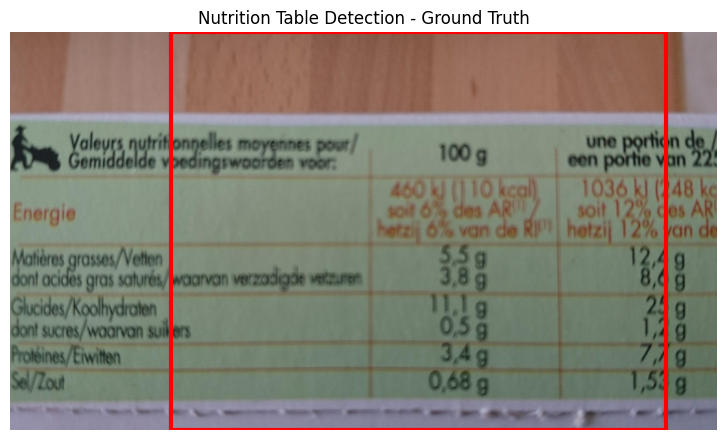

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(17,10),(987,987)<|box_end|><|im_end|>
Predicted Bounding Box:


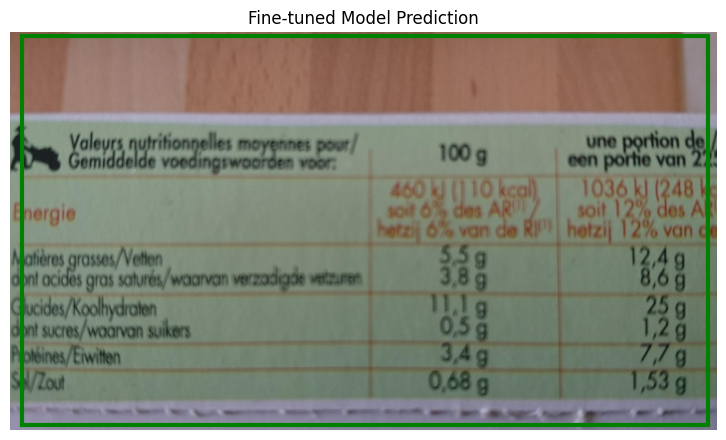


--- Sample 2/10 (Validation Index: 14) ---
Ground Truth:


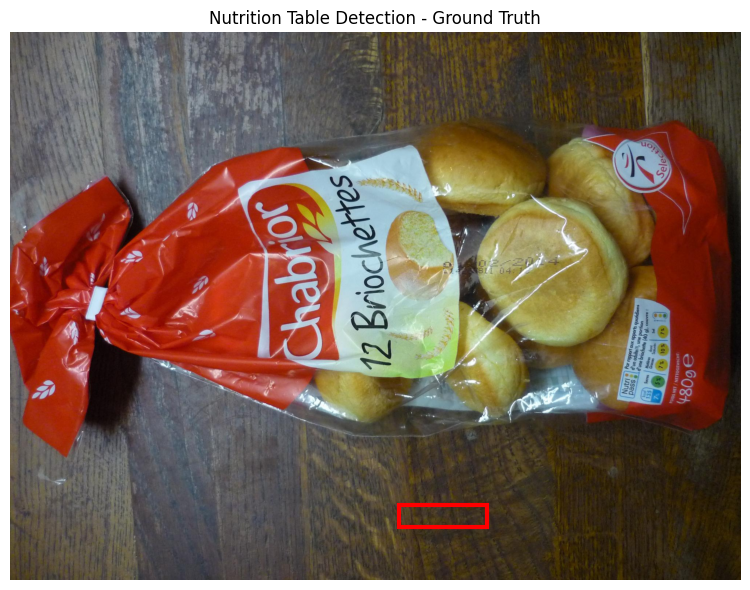

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(597,371),(799,586)<|box_end|><|im_end|>
Predicted Bounding Box:


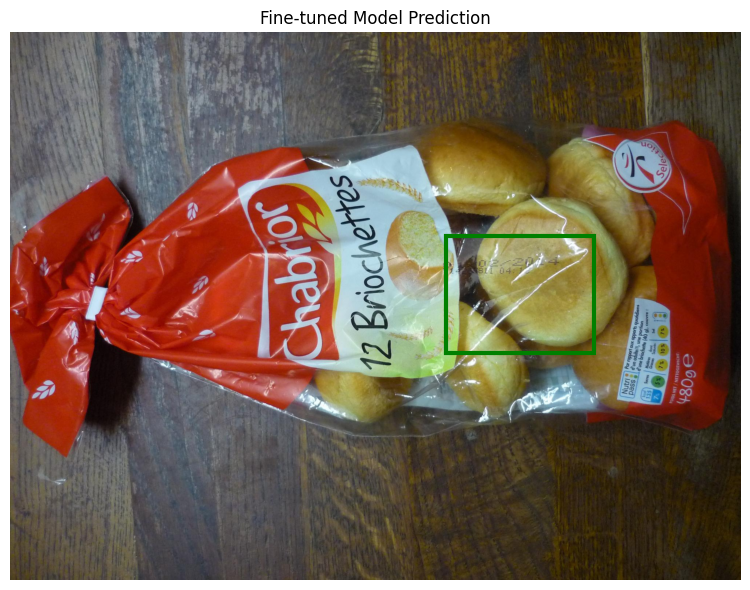


--- Sample 3/10 (Validation Index: 3) ---
Ground Truth:


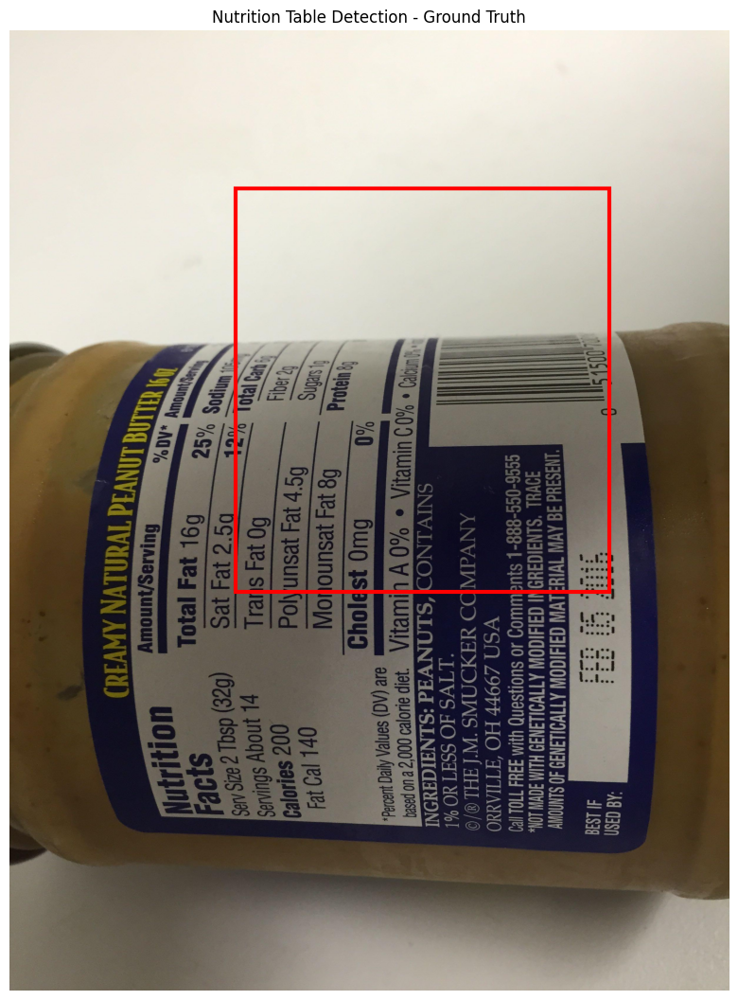

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(177,307),(589,619)<|box_end|><|im_end|>
Predicted Bounding Box:


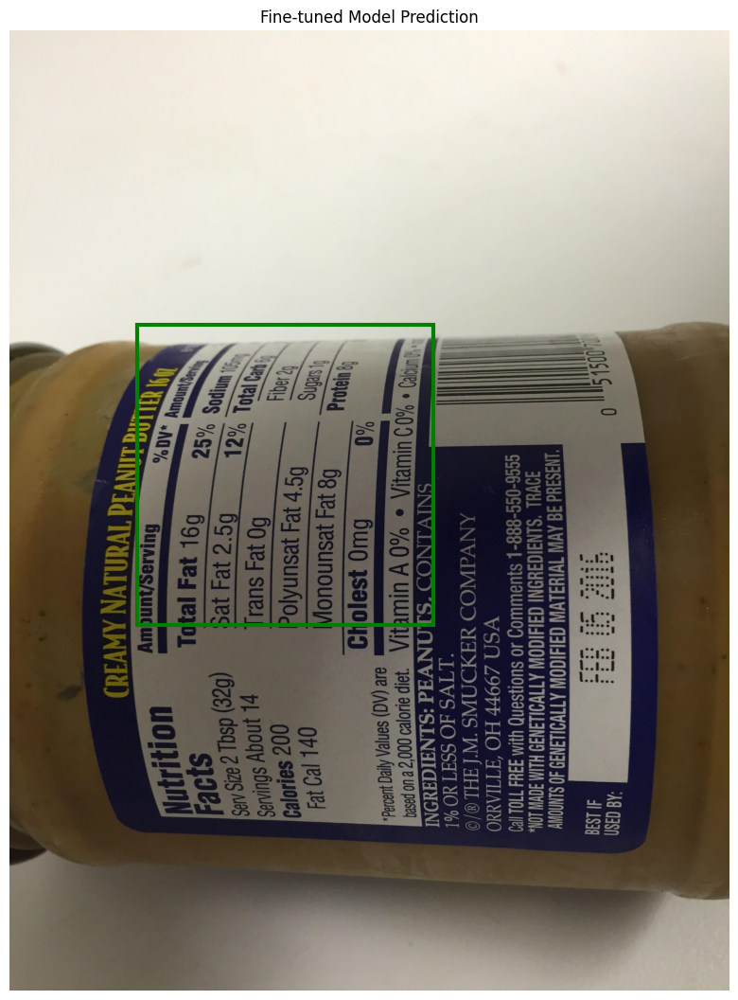


--- Sample 4/10 (Validation Index: 94) ---
Ground Truth:


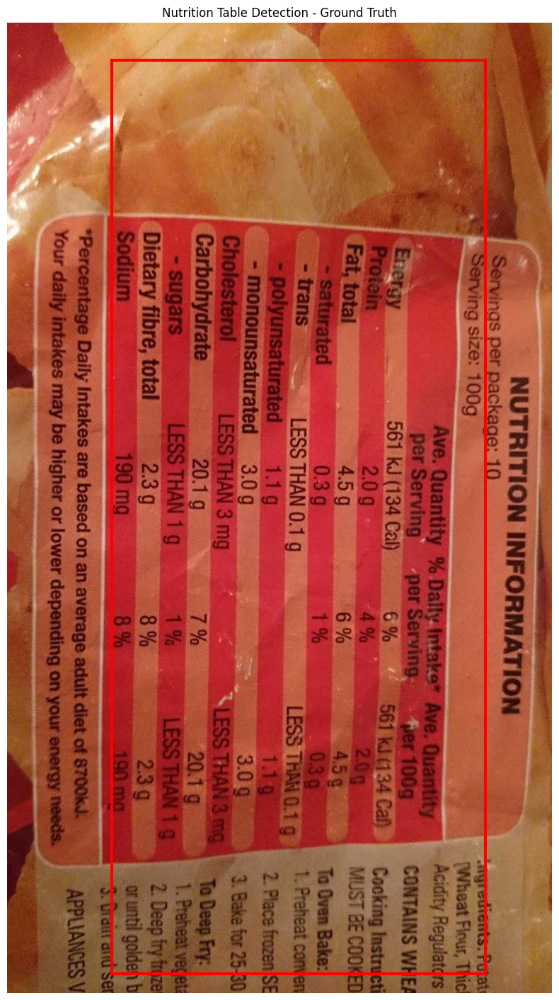

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(17,10),(995,996)<|box_end|><|im_end|>
Predicted Bounding Box:


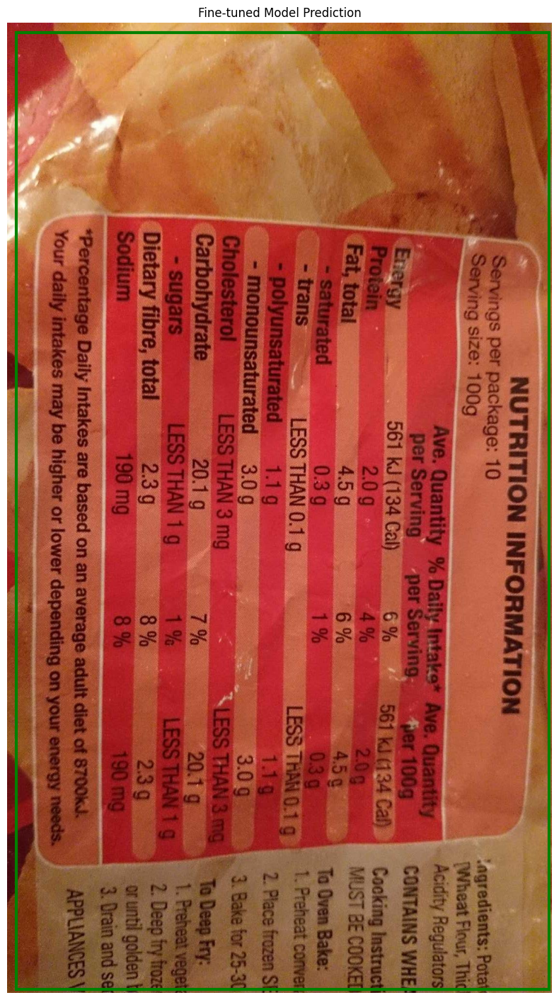


--- Sample 5/10 (Validation Index: 35) ---
Ground Truth:


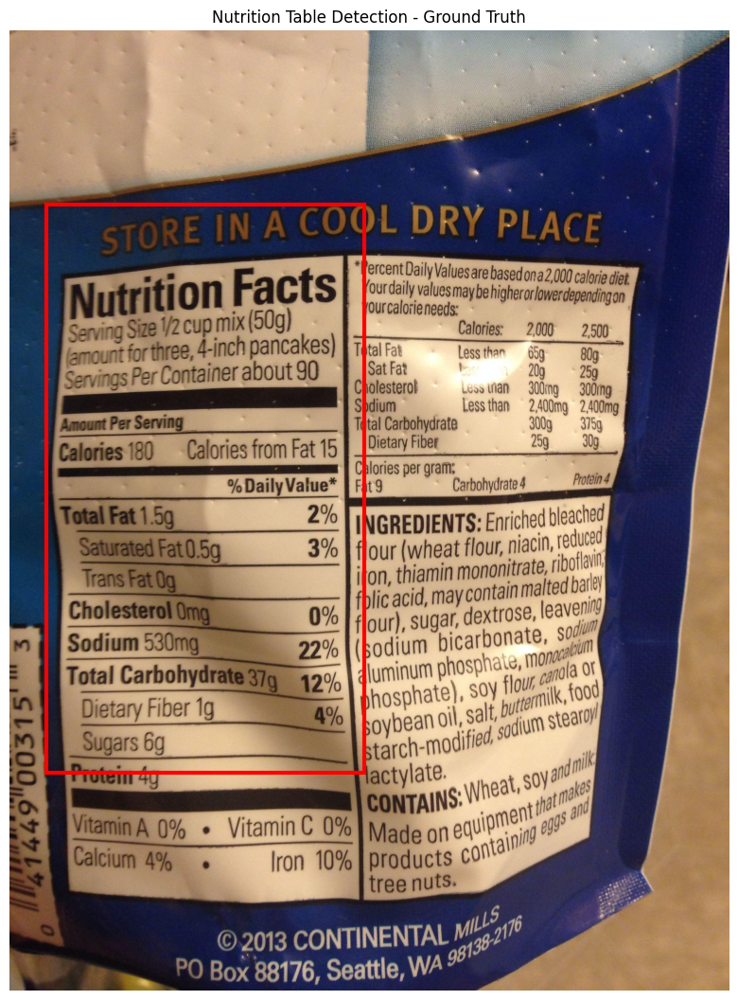

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(17,10),(995,989)<|box_end|><|im_end|>
Predicted Bounding Box:


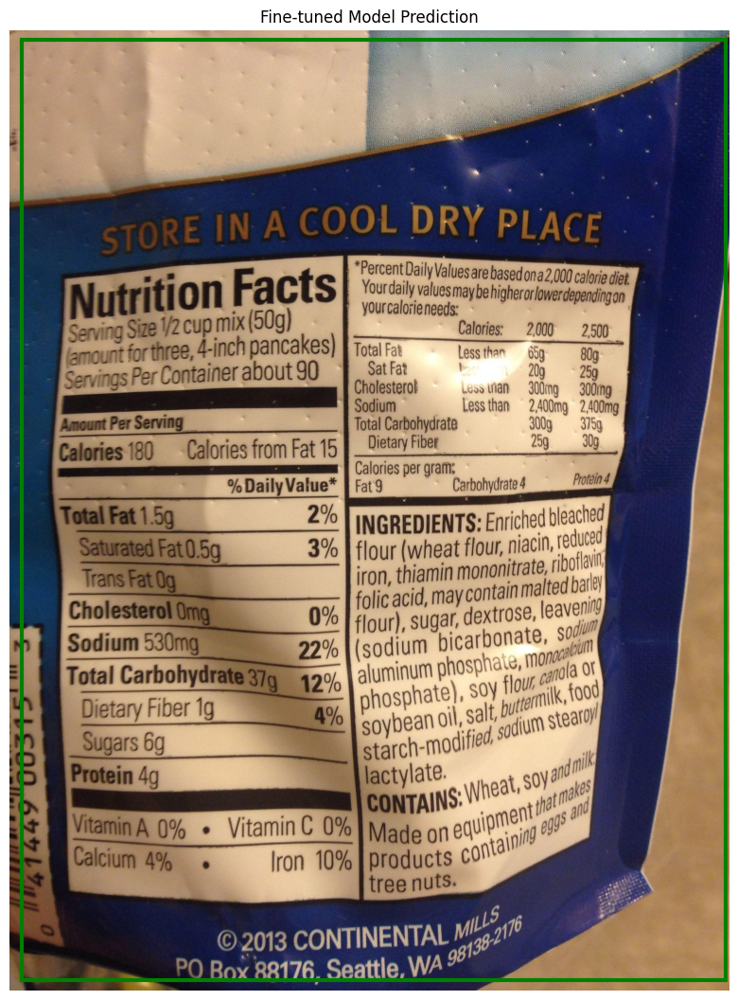


--- Sample 6/10 (Validation Index: 31) ---
Ground Truth:


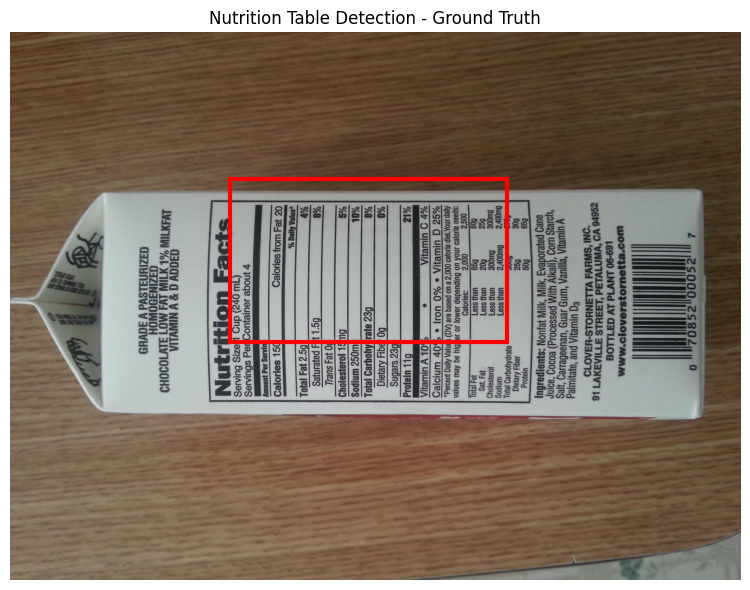

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(317,187),(689,689)<|box_end|><|im_end|>
Predicted Bounding Box:


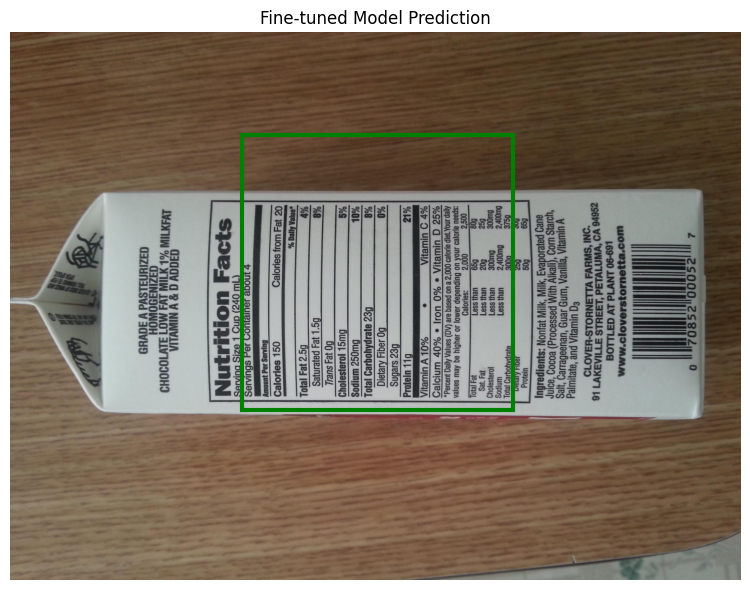


--- Sample 7/10 (Validation Index: 28) ---
Ground Truth:


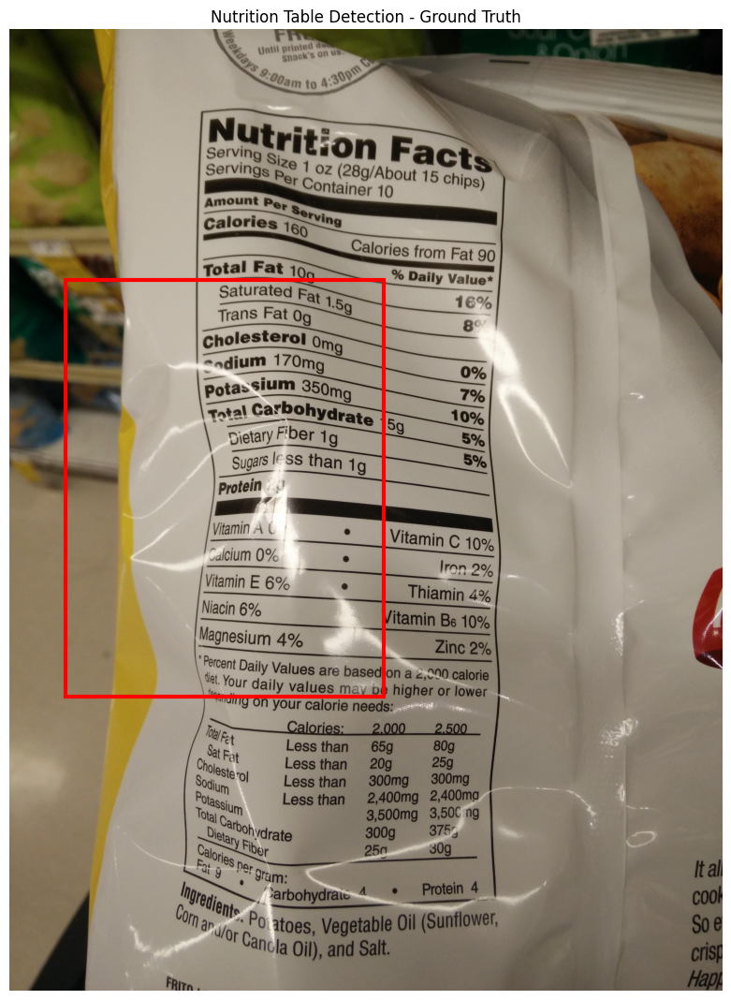

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(17,10),(995,989)<|box_end|><|im_end|>
Predicted Bounding Box:


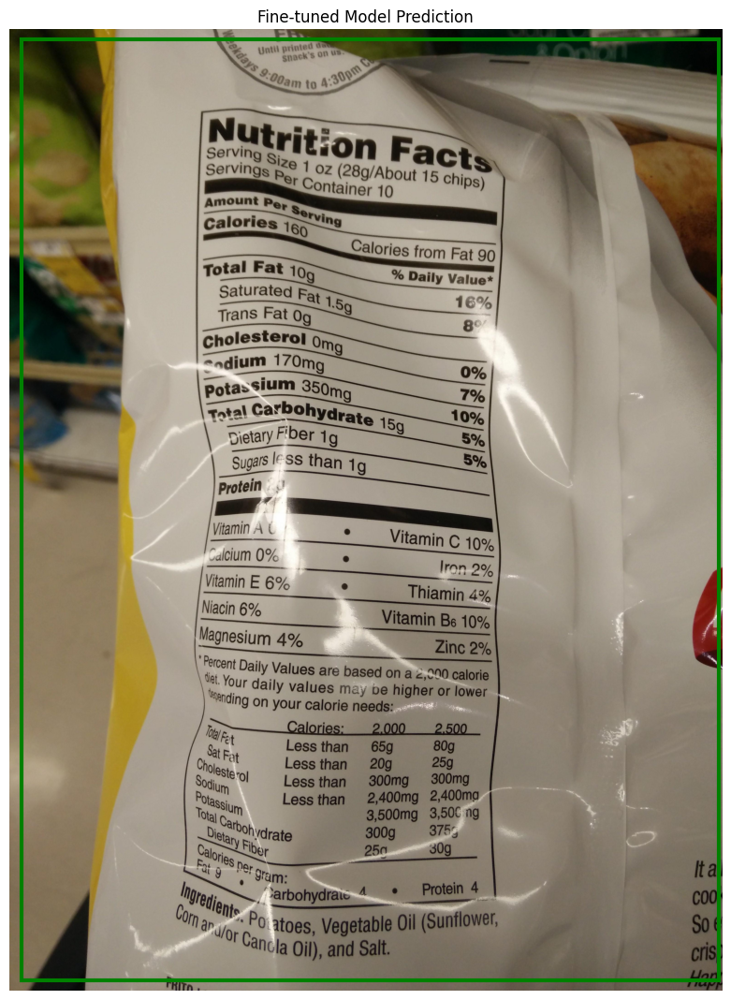


--- Sample 8/10 (Validation Index: 17) ---
Ground Truth:


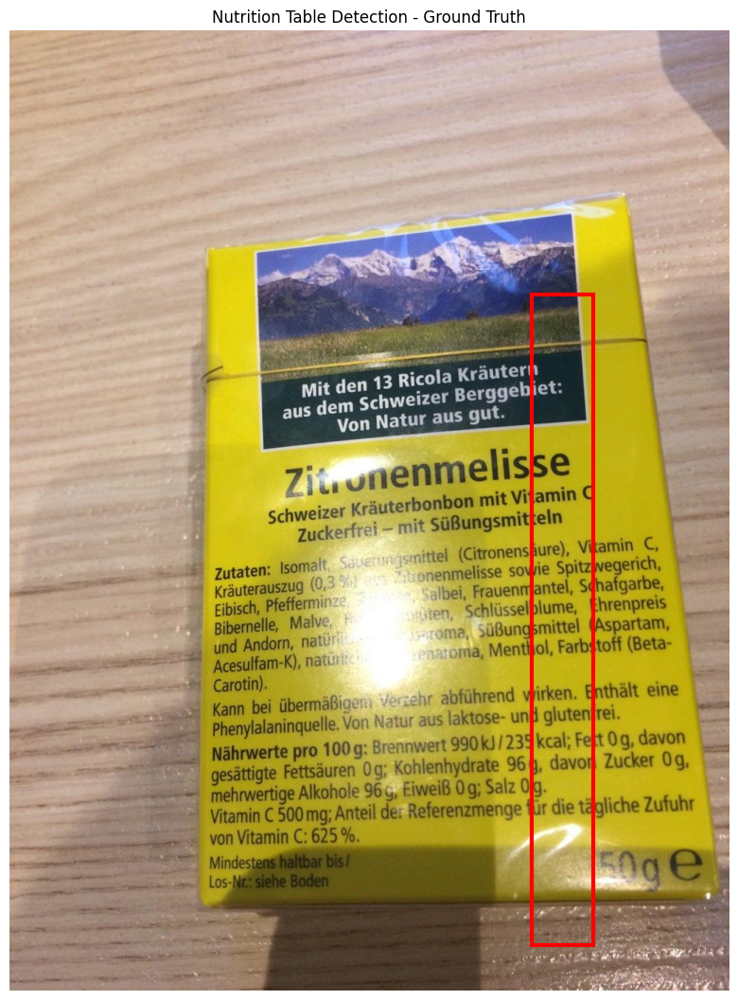

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(177,21),(837,887)<|box_end|><|im_end|>
Predicted Bounding Box:


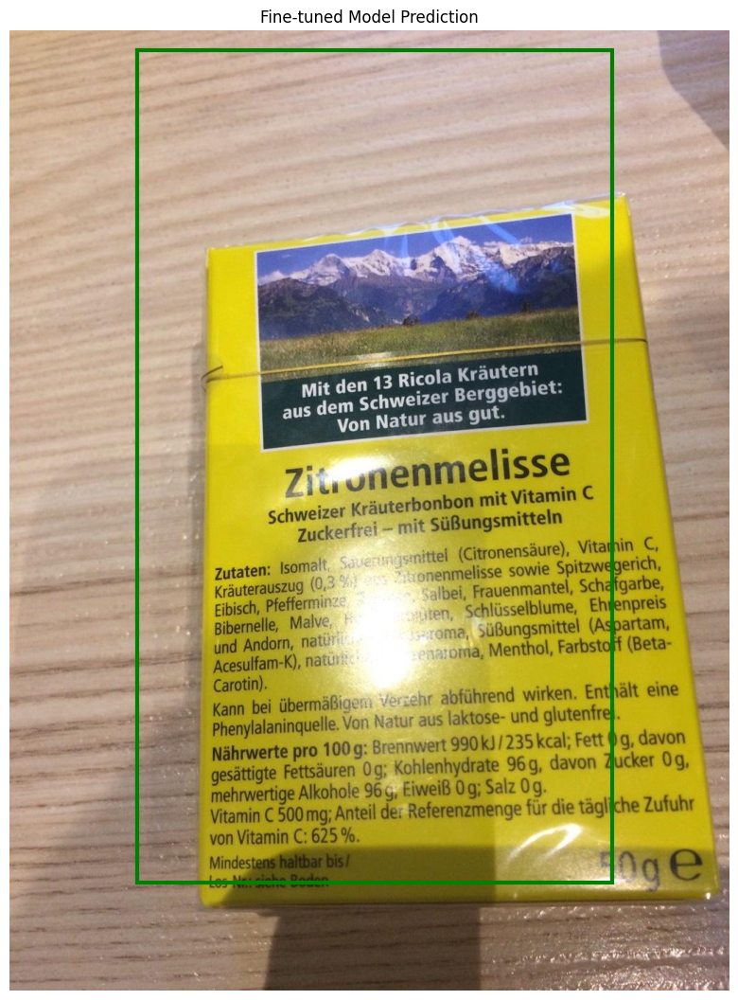


--- Sample 9/10 (Validation Index: 13) ---
Ground Truth:


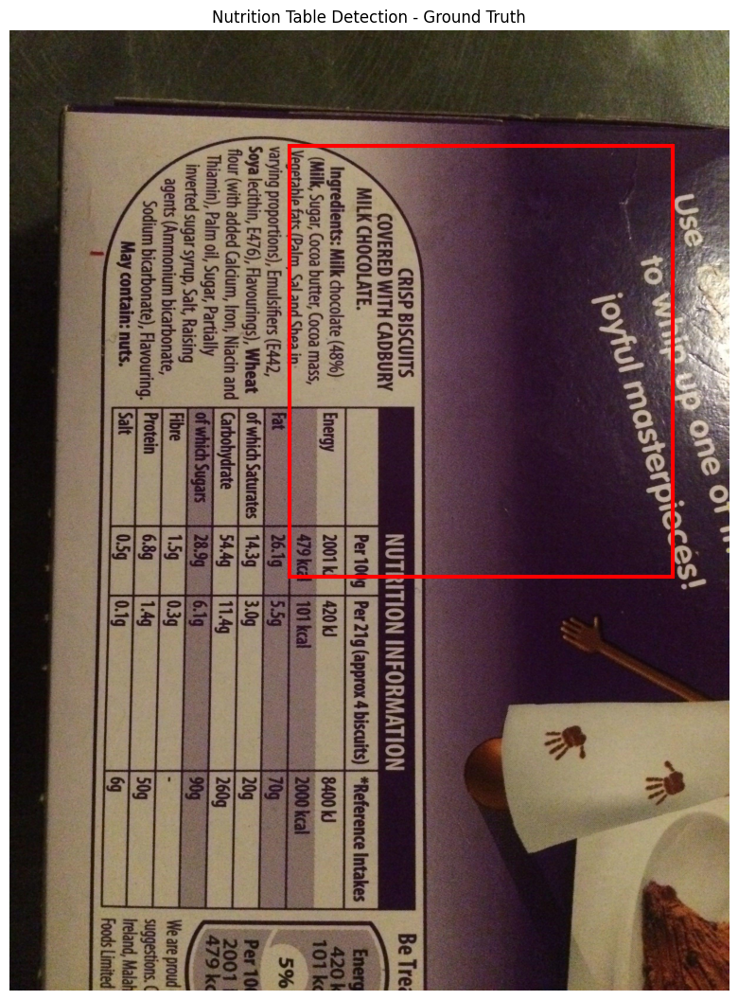

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(177,18),(807,687)<|box_end|><|im_end|>
Predicted Bounding Box:


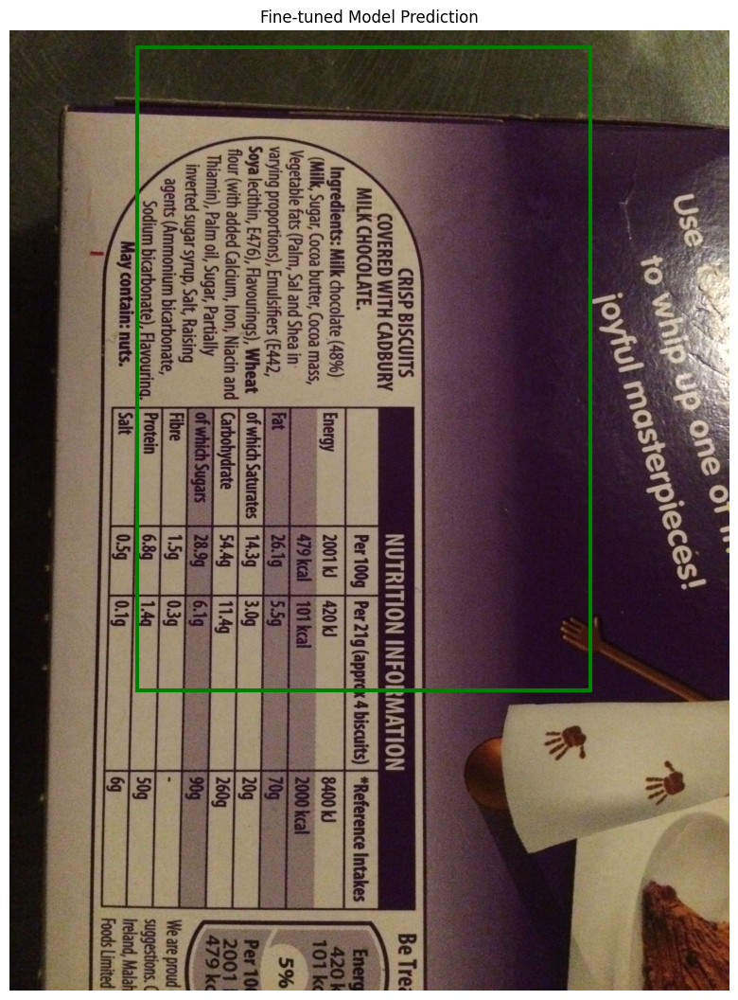


--- Sample 10/10 (Validation Index: 86) ---
Ground Truth:


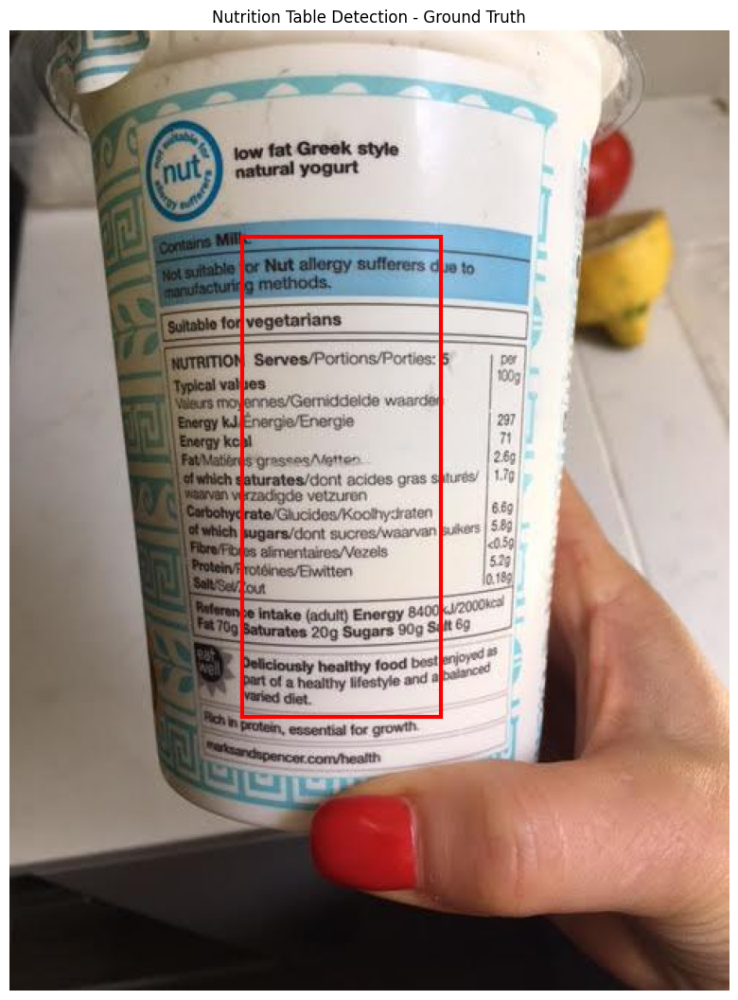

Running inference...
Model prediction: <|object_ref_start|>nutrition-table<|object_ref_end|><|box_start|>(177,18),(797,807)<|box_end|><|im_end|>
Predicted Bounding Box:


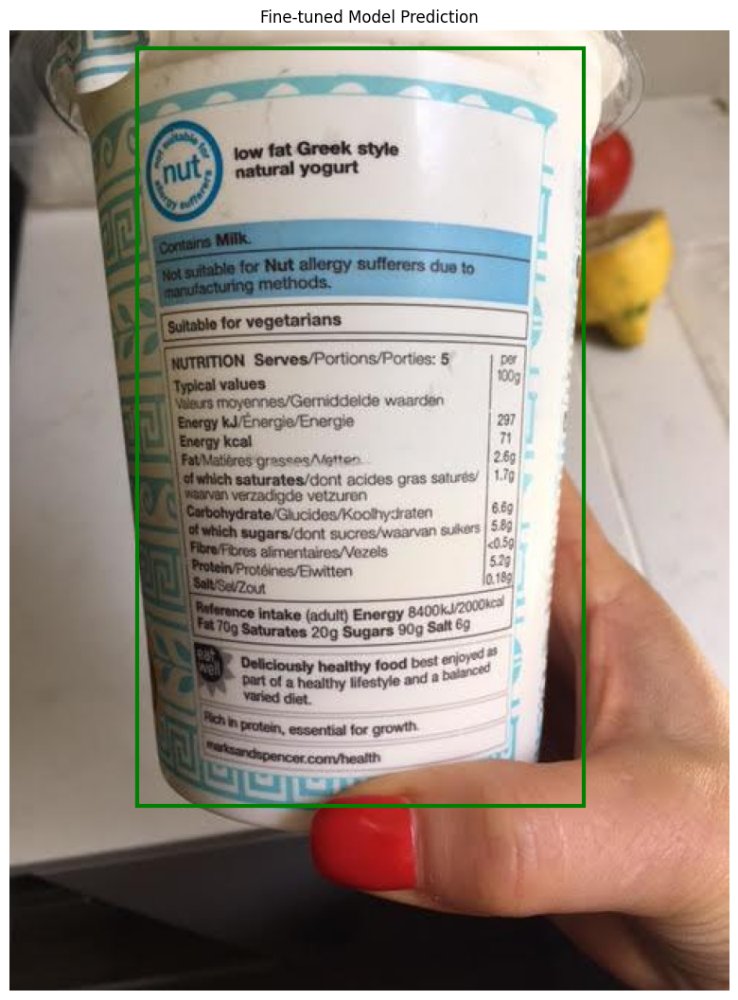

In [54]:
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Reuse the existing functions
# def parse_qwen_bbox(answer): ...
# def run_inference(model, processor, image, prompt="Detect the bounding box of the nutrition table."): ...
# def visualize_prediction(img, answer, processor): ...

print("Testing model on 10 random validation images...")

# Select 10 random indices from the validation set
num_samples_to_test = 10
random_indices = random.sample(range(len(chat_splits["val"])), min(num_samples_to_test, len(chat_splits["val"])))

for i, idx in enumerate(random_indices):
    print(f"\n--- Sample {i+1}/{num_samples_to_test} (Validation Index: {idx}) ---")
    sample = chat_splits["val"][idx]
    img = sample["image"].convert("RGB")

    # 1. Visualize Ground Truth
    print("Ground Truth:")
    show_sample_with_bbox(dataset['val'][idx]) # Use original dataset for ground truth display

    # 2. Run Inference
    print("Running inference...")
    predicted_answer = run_inference(model, processor, img)
    print(f"Model prediction: {predicted_answer}")

    # 3. Visualize Prediction
    print("Predicted Bounding Box:")
    visualize_prediction(img, predicted_answer, processor)


In [55]:
from google.colab import drive
import os
import json
from tqdm import tqdm

# 1. Mount Google Drive
print("Mounting Google Drive...")
drive.mount('/content/drive')

# Define the base path for saving the dataset in Google Drive
gdrive_dataset_path = '/content/drive/MyDrive/nutrition-table-dataset'

# Create the base directory if it doesn't exist
os.makedirs(gdrive_dataset_path, exist_ok=True)
print(f"Google Drive dataset path created: {gdrive_dataset_path}")

# Iterate through each split (train and val)
for split_name in ['train', 'val']:
    print(f"Processing {split_name} split...")
    split_data = dataset[split_name]
    split_dir = os.path.join(gdrive_dataset_path, split_name)
    os.makedirs(split_dir, exist_ok=True)

    annotations = []

    # Iterate through each sample in the split
    for i, sample in enumerate(tqdm(split_data, desc=f"Saving {split_name} images and annotations")):
        # Generate a unique filename for the image
        image_id = sample['image_id']
        image_filename = f"{image_id}.jpg"
        image_path = os.path.join(split_dir, image_filename)

        # Save the image
        if sample['image']:
            sample['image'].save(image_path, "JPEG")

        # Collect annotation data
        annotation_entry = {
            "image_id": image_id,
            "width": sample['width'],
            "height": sample['height'],
            "meta": sample['meta'],
            "objects": sample['objects']
        }
        annotations.append(annotation_entry)

    # Save all annotations for the current split to a single JSON file
    annotations_filename = os.path.join(split_dir, 'annotations.json')
    with open(annotations_filename, 'w') as f:
        json.dump(annotations, f, indent=4)
    print(f"Saved {len(annotations)} annotations to {annotations_filename}")

print("Dataset download to Google Drive complete!")

Mounting Google Drive...
Mounted at /content/drive
Google Drive dataset path created: /content/drive/MyDrive/nutrition-table-dataset
Processing train split...


Saving train images and annotations: 100%|██████████| 1083/1083 [01:08<00:00, 15.88it/s]


Saved 1083 annotations to /content/drive/MyDrive/nutrition-table-dataset/train/annotations.json
Processing val split...


Saving val images and annotations: 100%|██████████| 123/123 [00:07<00:00, 15.88it/s]

Saved 123 annotations to /content/drive/MyDrive/nutrition-table-dataset/val/annotations.json
Dataset download to Google Drive complete!
